# <center> Taxi New York | Analysis and ML</center>

1. [Import libraries](#impo_lib)
2. [Data reading](#data_rea)
3. [Data processing](#data_pro)
4. [Data visualization](#data_vis)
4. [Quantitive Analyses](#quan_ana)
4. [Predictive Analyses | Machine Learning](#pred_ana)

### 1. Import libraries <a id = "imp_lib">*</a>

In [1]:
import pandas as pd
import numpy as np
from math import sqrt

from sklearn import preprocessing 
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import mean_squared_error, accuracy_score
from sklearn.tree import DecisionTreeRegressor, DecisionTreeClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression, LogisticRegression, RidgeCV
from sklearn.svm import LinearSVR
import xgboost as xgb
from lightgbm import LGBMRegressor

from tensorflow.keras.layers import Input, Dense, Activation,Dropout
from tensorflow.keras.models import Model

import datetime
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

pd.options.display.float_format = '{:.4f}'.format

In [2]:
import warnings
warnings.filterwarnings("ignore")

### 2. Data reading <a id = "data_red">*</a>

<a href="https://www1.nyc.gov/site/tlc/about/tlc-trip-record-data.page">Link to data for downloading</a>

In [3]:
df =pd.read_csv("yellow_tripdata_2015-02.csv")
#df =pd.read_csv("yellow_tripdata_2015-02.csv", nrows=5000000)
df.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,pickup_longitude,pickup_latitude,RateCodeID,store_and_fwd_flag,dropoff_longitude,dropoff_latitude,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount
0,2,2015-02-08 11:33:46,2015-02-08 11:37:45,1,0.5600,-73.9499,40.7174,1,N,-73.9500,40.7240,1,4.5000,0.0000,0.5000,1.0600,0.0000,0.3000,6.3600
1,2,2015-02-28 23:52:39,2015-03-01 00:00:03,1,1.2400,-73.9835,40.7561,1,N,-73.9895,40.7679,1,6.5000,0.5000,0.5000,1.5600,0.0000,0.3000,9.3600
2,2,2015-02-28 23:52:39,2015-03-01 00:03:25,1,2.0700,-74.0032,40.7331,1,N,-73.9924,40.7151,1,10.0000,0.5000,0.5000,2.2600,0.0000,0.3000,13.5600
3,2,2015-02-28 23:52:39,2015-03-01 00:04:58,1,2.2900,-73.9585,40.7605,1,N,-73.9792,40.7367,1,10.5000,0.5000,0.5000,2.3600,0.0000,0.3000,14.1600
4,2,2015-02-28 23:52:39,2015-03-01 00:00:16,1,1.3600,-73.9741,40.7513,1,N,-73.9818,40.7631,1,7.0000,0.5000,0.5000,1.0000,0.0000,0.3000,9.3000


In [4]:
df = df[['tpep_pickup_datetime', 'tpep_dropoff_datetime', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude', 'trip_distance', 'total_amount']]
df.head()

,tpep_pickup_datetime,tpep_dropoff_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_distance,total_amount
0,2015-02-08 11:33:46,2015-02-08 11:37:45,-73.9499,40.7174,-73.9500,40.7240,0.5600,6.3600
1,2015-02-28 23:52:39,2015-03-01 00:00:03,-73.9835,40.7561,-73.9895,40.7679,1.2400,9.3600
2,2015-02-28 23:52:39,2015-03-01 00:03:25,-74.0032,40.7331,-73.9924,40.7151,2.0700,13.5600
3,2015-02-28 23:52:39,2015-03-01 00:04:58,-73.9585,40.7605,-73.9792,40.7367,2.2900,14.1600
4,2015-02-28 23:52:39,2015-03-01 00:00:16,-73.9741,40.7513,-73.9818,40.7631,1.3600,9.3000


Description of the columns:

| Name | ProbDistribution | 
| --- | --- | 
| tpep_pickup_datetime | The date and time when the meter was engaged. | 
| tpep_dropoff_datetime | The date and time when the meter was disengaged.  | 
| pickup_longitude | Pickup longitude coordinate | 
| pickup_latitude | Pickup latitude coordinate | 
| dropoff_longitude | Dropoff longitude coordinate | 
| dropoff_latitude | Dropoff latitude coordinate | 
| trip_distance | The elapsed trip distance in miles reported by the taximeter. | 
| total_amount | The total amount charged to passengers. Does not include cash tips. | 

### Data preprocessing

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12450521 entries, 0 to 12450520
Data columns (total 8 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   tpep_pickup_datetime   object 
 1   tpep_dropoff_datetime  object 
 2   pickup_longitude       float64
 3   pickup_latitude        float64
 4   dropoff_longitude      float64
 5   dropoff_latitude       float64
 6   trip_distance          float64
 7   total_amount           float64
dtypes: float64(6), object(2)
memory usage: 759.9+ MB


#### Change datatype

In [6]:
#cambiamos a tipo "fecha"
df['tpep_pickup_datetime'] = pd.to_datetime(df['tpep_pickup_datetime'])
df['tpep_dropoff_datetime'] = pd.to_datetime(df['tpep_dropoff_datetime'])

#### Drop na & duplicates

In [7]:
#Nos cargamos los NAs, y los duplicados (si los hubiera)
df.dropna(inplace = True)
df.drop_duplicates(keep='first',inplace=True)

#### Calculate time

In [8]:
# calculate duration of the trip
df = df.assign(total_time = lambda x: df['tpep_dropoff_datetime']-df['tpep_pickup_datetime']) 
df['total_time'] = df['total_time'].astype('timedelta64[s]')
df = df.drop(df[df['total_time']<1].index) # remove duration shorter than 1s

In [9]:
df.drop(['tpep_dropoff_datetime'],axis=1, inplace=True) # no more interest

In [10]:
df.shape

(12434803, 8)

#### Miles to Km and clean

In [11]:
df['trip_distance'] = df['trip_distance']*1.61
df=df[df['trip_distance']>=1]

#### Expand dates

In [12]:
#la fecha, la fecha concreta no nos interesa tanto. Por si es útil nos quedamos con el día de la semana,
#En cuanto a la hora, la separamos en hora y minuto. Los segundos no interesan (están incuidos en el tiempo de viaje en segundos)
for col in ['tpep_pickup_datetime']:
    date_col = pd.to_datetime(df[col])
    df[col + '_hour'] = date_col.dt.hour
    df[col + '_minute'] = date_col.dt.minute
    #df[col + '_second'] = date_col.dt.second
    df[col + '_weekday'] = date_col.dt.day_name()
    #df[col + '_day'] = date_col.dt.day
    #df[col + '_month'] = date_col.dt.month
    #df[col + '_year'] = date_col.dt.year
    
    del df[col]

df.head(5)

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_distance,total_amount,total_time,tpep_pickup_datetime_hour,tpep_pickup_datetime_minute,tpep_pickup_datetime_weekday
1,-73.9835,40.7561,-73.9895,40.7679,1.9964,9.3600,444.0000,23,52,Saturday
2,-74.0032,40.7331,-73.9924,40.7151,3.3327,13.5600,646.0000,23,52,Saturday
3,-73.9585,40.7605,-73.9792,40.7367,3.6869,14.1600,739.0000,23,52,Saturday
4,-73.9741,40.7513,-73.9818,40.7631,2.1896,9.3000,457.0000,23,52,Saturday
5,-73.9810,40.7298,-73.9758,40.7407,1.5456,8.7600,313.0000,23,52,Saturday


#### Filter longitude and latitude

In [13]:
df = df[(df['pickup_longitude']>-75) & (df['pickup_longitude']<-70)]
df = df[(df['pickup_latitude']>40) & (df['pickup_latitude']<42)]
df = df[(df['dropoff_longitude']>-75) & (df['dropoff_longitude']<70)]
#df[(df['dropoff_latitude']>40) & (df['dropoff_latitude']<42)] no need

#### Column analysis & winsorization

In [14]:
df.pickup_latitude.describe()

count   10996009.0000
mean          40.7506
std            0.0275
min           40.0243
25%           40.7364
50%           40.7530
75%           40.7675
max           41.7761
Name: pickup_latitude, dtype: float64

Boxplot of the variables, not run if there is a high number of register and low CPU.

In [15]:
#Dibujamos el plotly de la longitud
#fig = px.box(df, y="total_time")
#fig.show()

We should have done an analysis of all the columns before keep going. Now we remove outliers, it's done with winsorization, as there are many data we can remove winsorization without hesitating too much

In [16]:
cols_to_winsorization =  ['pickup_longitude','trip_distance','total_time','total_amount','dropoff_longitude','dropoff_latitude']

for col in cols_to_winsorization:
    date_col = df[col]
    
    limit_inf = np.quantile(date_col, 0.01)
    limit_sup = np.quantile(date_col, 0.99)

    drop_inf = df[date_col<limit_inf].index
    drop_sup = df[date_col>limit_sup].index

    df.drop(drop_inf, inplace=True)
    df.drop(drop_sup, inplace=True)
    print(f'Winsorization done to {date_col.name}, number of rows in dataframe: {df.shape[0]}')

Winsorization done to pickup_longitude, number of rows in dataframe: 10776230
Winsorization done to trip_distance, number of rows in dataframe: 10573124
Winsorization done to total_time, number of rows in dataframe: 10362761
Winsorization done to total_amount, number of rows in dataframe: 10233696
Winsorization done to dropoff_longitude, number of rows in dataframe: 10029107
Winsorization done to dropoff_latitude, number of rows in dataframe: 9828537


### Data Visualization <a id = "data_vis">*</a>

In [22]:
df_vis = df.sample(frac=0.01, random_state=1) 

In [23]:
px.scatter_mapbox(df_vis, lat="pickup_latitude", lon="pickup_longitude", size="total_time", mapbox_style="open-street-map", 
                  zoom=10.5, width=1000, height=600, size_max=7, title="Pickup places")

In [24]:
px.density_mapbox(df_vis, lat="pickup_latitude", lon="pickup_longitude", mapbox_style="stamen-terrain",
                  z='total_time', radius=8, zoom=9.5, width=1000, height=600, opacity=0.7, title="Pickup places density")

In [25]:
del df_vis

### Quantitative analysis <a id = "quan_ana">*</a>

#### 2.1 Which route has the highest price/km ratio? Which route has the highest time/km ratio? Which route has the highest price/km ratio? Which route has the highest price/time ratio?

Which route has the highest price/km ratio?

In [26]:
var_temp = df['total_amount']/df['trip_distance']
print(df.loc[var_temp.idxmax])
del var_temp

pickup_longitude                -74.0052
pickup_latitude                  40.7188
dropoff_longitude               -74.0114
dropoff_latitude                 40.7138
trip_distance                     1.1270
total_amount                     50.4400
total_time                     1418.0000
tpep_pickup_datetime_hour              7
tpep_pickup_datetime_minute           31
tpep_pickup_datetime_weekday    Thursday
Name: 2048201, dtype: object


Which route has the highest time/km ratio? 

In [27]:
var_temp = df['total_time']/df['trip_distance']
print(df.loc[var_temp.idxmax])
del var_temp

pickup_longitude                -74.0036
pickup_latitude                  40.7223
dropoff_longitude               -74.0020
dropoff_latitude                 40.7296
trip_distance                     1.1270
total_amount                     26.8000
total_time                     2682.0000
tpep_pickup_datetime_hour             16
tpep_pickup_datetime_minute           43
tpep_pickup_datetime_weekday     Tuesday
Name: 9340891, dtype: object


Which route has the highest price/time ratio?

In [28]:
var_temp = df['total_amount']/df['total_time']
print(df.loc[var_temp.idxmax])
del var_temp

pickup_longitude               -74.0063
pickup_latitude                 40.7835
dropoff_longitude              -74.0022
dropoff_latitude                40.7894
trip_distance                    1.8676
total_amount                    50.8000
total_time                     186.0000
tpep_pickup_datetime_hour             1
tpep_pickup_datetime_minute          36
tpep_pickup_datetime_weekday    Tuesday
Name: 12263507, dtype: object


#### 2.2 What is the journey where the price/km ratio is lowest? What is the journey where the time/km ratio is lowest? What is the journey where the price/time ratio is lowest? What is the journey where the price/time ratio is lowest?

Which route has the lowest price/km ratio?

In [29]:
var_temp = df['total_amount']/df['trip_distance']
print(df.loc[var_temp.idxmin])
del var_temp

pickup_longitude                 -73.9849
pickup_latitude                   40.7687
dropoff_longitude                -73.9849
dropoff_latitude                  40.7687
trip_distance                     27.8530
total_amount                       5.8000
total_time                       317.0000
tpep_pickup_datetime_hour              10
tpep_pickup_datetime_minute             3
tpep_pickup_datetime_weekday    Wednesday
Name: 4163429, dtype: object


Which route has the lowest time/km ratio? 

In [30]:
var_temp = df['total_time']/df['trip_distance']
print(df.loc[var_temp.idxmin])
del var_temp

pickup_longitude               -73.9278
pickup_latitude                 40.7664
dropoff_longitude              -73.9278
dropoff_latitude                40.7664
trip_distance                   24.3110
total_amount                    50.7500
total_time                     215.0000
tpep_pickup_datetime_hour            22
tpep_pickup_datetime_minute          51
tpep_pickup_datetime_weekday     Friday
Name: 2545215, dtype: object


Which route has the lowest price/time ratio?

In [31]:
var_temp = df['total_amount']/df['total_time']
print(df.loc[var_temp.idxmin])
del var_temp

pickup_longitude                -74.0033
pickup_latitude                  40.7389
dropoff_longitude               -73.9888
dropoff_latitude                 40.7610
trip_distance                     4.6690
total_amount                      5.8000
total_time                     2697.0000
tpep_pickup_datetime_hour             23
tpep_pickup_datetime_minute            8
tpep_pickup_datetime_weekday      Monday
Name: 12014064, dtype: object


#### 2.3 Shows the evolution of the average journey time over the day. Shows the evolution of the average trip distance throughout the day.

In [32]:
mean_time_by_hour = df.groupby(by=['tpep_pickup_datetime_hour'])['total_time'].mean().to_frame()
mean_time_by_hour["pickup_hour"] = range(0,24)
mean_time_by_hour.head()

,total_time,pickup_hour
tpep_pickup_datetime_hour,,
0,738.1298,0
1,715.0129,1
2,701.8886,2
3,701.1070,3
4,699.6368,4


In [33]:
fig = px.line(mean_time_by_hour, x='pickup_hour', y='total_time', markers=True)
fig.update_layout(height=600, width=980, title_text="Total time based on pick up hour")
fig.update_traces(marker_size=8)
fig.update_yaxes(rangemode="tozero")
fig.show()

## Predictive Analytics |  Machine Learning <a id = "pred_ana">*</a>

#### 3.1 What are the areas where you are most likely to pick up a taxi depending on the time of day?

#### Preprocessing data

In [46]:
df_ml = df
df_ml.head()

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_distance,total_amount,total_time,tpep_pickup_datetime_hour,tpep_pickup_datetime_minute,tpep_pickup_datetime_weekday
1,-73.9835,40.7561,-73.9895,40.7679,1.9964,9.3600,444.0000,23,52,Saturday
2,-74.0032,40.7331,-73.9924,40.7151,3.3327,13.5600,646.0000,23,52,Saturday
3,-73.9585,40.7605,-73.9792,40.7367,3.6869,14.1600,739.0000,23,52,Saturday
4,-73.9741,40.7513,-73.9818,40.7631,2.1896,9.3000,457.0000,23,52,Saturday
5,-73.9810,40.7298,-73.9758,40.7407,1.5456,8.7600,313.0000,23,52,Saturday


In [47]:
df_ml = df_ml[['dropoff_longitude', 'dropoff_latitude', 'tpep_pickup_datetime_hour']]
df_ml.head()

,dropoff_longitude,dropoff_latitude,tpep_pickup_datetime_hour
1,-73.9895,40.7679,23
2,-73.9924,40.7151,23
3,-73.9792,40.7367,23
4,-73.9818,40.7631,23
5,-73.9758,40.7407,23


In [48]:
min_max_scaler = preprocessing.MinMaxScaler() 
df_ml = min_max_scaler.fit_transform(df_ml)
df_ml = pd.DataFrame(df_ml) 
df_ml.head()

,0,1,2
0,0.1647,0.5941,1.0000
1,0.1458,0.2626,1.0000
2,0.2336,0.3980,1.0000
3,0.2166,0.5645,1.0000
4,0.2565,0.4232,1.0000


In [49]:
x = df_ml[0].values
y = df_ml[1].values

#### KMeans

Plot to get optimun value of k.

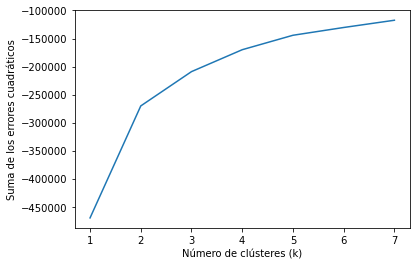

In [65]:
nc = range(1, 8)
kmeans = [KMeans(n_clusters=i) for i in nc]
score = [kmeans[i].fit(df_ml).score(df_ml) for i in range(len(kmeans))]

plt.xlabel('Número de clústeres (k)')
plt.ylabel('Suma de los errores cuadráticos')
plt.plot(nc,score)

In [38]:
kmeans = KMeans(n_clusters=3).fit(df_ml)
centroids = kmeans.cluster_centers_
centroids = min_max_scaler.inverse_transform(centroids)[:, 0:2]

In [50]:
labels = kmeans.predict(df_ml) # predict labels

arr = min_max_scaler.inverse_transform(df_ml.iloc[:,0:3])
df_ml = pd.DataFrame({'dropoff_longitude': arr[:, 0], 'dropoff_latitude': arr[:, 1], 'tpep_pickup_datetime_hour': arr[:, 2]})
df_ml['tpep_pickup_datetime_hour'] = round(df_ml['tpep_pickup_datetime_hour'],0)
df_ml['label'] = labels
df_ml.head()

,dropoff_longitude,dropoff_latitude,tpep_pickup_datetime_hour,label
0,-73.9895,40.7679,23.0000,0
1,-73.9924,40.7151,23.0000,0
2,-73.9792,40.7367,23.0000,0
3,-73.9818,40.7631,23.0000,0
4,-73.9758,40.7407,23.0000,0


We get the **centroids** for each hour in which there are the most taxis available 

In [51]:
df_centroids = df_ml.groupby(['tpep_pickup_datetime_hour','label']).size()
df_centroids

tpep_pickup_datetime_hour  label
0.0000                     1        362556
1.0000                     1        256656
2.0000                     1        192528
3.0000                     1        138405
4.0000                     1         95658
5.0000                     1         83184
                           2            38
6.0000                     1        198780
                           2           103
7.0000                     1        362443
                           2           438
8.0000                     1        438554
                           2          6103
9.0000                     1        449125
                           2         11104
10.0000                    1        428898
                           2         24586
11.0000                    0          2292
                           1        396501
                           2         74124
12.0000                    0         61596
                           1        274247
                     

In [52]:
centroids_list = []

for i in range(0,24):
    centroids_list.append(df_centroids[i].idxmax())
    
data = {'hour':range(0,24), 'centroide':centroids_list}
df_centroids = pd.DataFrame(data)
df_centroids

,hour,centroide
0,0,1
1,1,1
2,2,1
3,3,1
4,4,1
5,5,1
6,6,1
7,7,1
8,8,1
9,9,1


The **best places to take a taxi** depending on the hour are:
- 0-12h centroid 1, in the center.
- 12-15h centroid 2, in the north.
- 15-24h centroid 0, in the south.

For each hour we have a centroid, i.e. coordinates, of where it is most likely to find an available taxi, the centroids are displayed below:

In [53]:
df_centroids_lonlat = pd.DataFrame({'centroid_longitude': centroids[:, 0], 'centroid_latitude': centroids[:, 1]})

px.scatter_mapbox(df_centroids_lonlat, lat="centroid_latitude", lon="centroid_longitude", mapbox_style="open-street-map", 
                  zoom=10.5, width=1000, height=600, size="centroid_latitude",
                  title="Centroids for getting a taxi depending on the hour of day")

#### 3.2 Design a model that, given a time, origin coordinates, and destination coordinates, predicts the duration of the journey and its cost. It shows the relevance of the attributes of the dataset.

In [58]:
df_ml = df.sample(frac=0.4, random_state=1) #edit frac depending on computational resources
df_ml['trip_distance']=round(df_ml['trip_distance'])
df_ml = pd.get_dummies(df_ml, columns=["tpep_pickup_datetime_weekday"])

df_ml

,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_distance,total_amount,total_time,tpep_pickup_datetime_hour,tpep_pickup_datetime_minute,tpep_pickup_datetime_weekday_Friday,tpep_pickup_datetime_weekday_Monday,tpep_pickup_datetime_weekday_Saturday,tpep_pickup_datetime_weekday_Sunday,tpep_pickup_datetime_weekday_Thursday,tpep_pickup_datetime_weekday_Tuesday,tpep_pickup_datetime_weekday_Wednesday
10259159,-73.9443,40.7881,-73.9591,40.8003,3.0000,11.3000,688.0000,19,14,0,0,0,0,0,0,1
339660,-73.9784,40.7455,-73.9911,40.7554,2.0000,10.5600,477.0000,2,21,0,0,0,1,0,0,0
7793604,-73.9780,40.7525,-73.8721,40.7745,17.0000,38.1300,1492.0000,12,38,0,0,0,0,1,0,0
3937363,-73.9880,40.7384,-73.9385,40.8172,10.0000,21.3000,1071.0000,3,36,1,0,0,0,0,0,0
1903702,-73.9717,40.7606,-73.9585,40.7725,2.0000,9.8000,702.0000,14,2,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10805596,-73.9589,40.7750,-73.9797,40.7659,3.0000,9.8000,648.0000,11,56,0,0,0,1,0,0,0
11442348,-73.9883,40.7483,-73.9796,40.7744,4.0000,15.3400,644.0000,21,30,0,0,0,0,1,0,0
2525425,-73.9697,40.7971,-73.9583,40.8004,1.0000,7.8000,424.0000,18,2,0,1,0,0,0,0,0
5850407,-73.9874,40.7757,-73.9873,40.7659,1.0000,8.0000,290.0000,20,26,1,0,0,0,0,0,0


In [59]:
column_to_predict = 'trip_distance'

column_to_train = list(df_ml.columns)
column_to_train.remove(column_to_predict)
column_to_train

['pickup_longitude',
 'pickup_latitude',
 'dropoff_longitude',
 'dropoff_latitude',
 'total_amount',
 'total_time',
 'tpep_pickup_datetime_hour',
 'tpep_pickup_datetime_minute',
 'tpep_pickup_datetime_weekday_Friday',
 'tpep_pickup_datetime_weekday_Monday',
 'tpep_pickup_datetime_weekday_Saturday',
 'tpep_pickup_datetime_weekday_Sunday',
 'tpep_pickup_datetime_weekday_Thursday',
 'tpep_pickup_datetime_weekday_Tuesday',
 'tpep_pickup_datetime_weekday_Wednesday']

In [60]:
X = df_ml.loc[:, column_to_train].values
y = df_ml.loc[:, column_to_predict].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=1)

print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(2751990, 15)
(1179425, 15)
(2751990,)
(1179425,)


#### Logistic Regression

In [61]:
%%time 
LR = LogisticRegression()
LR.fit(X_train, y_train)

Wall time: 7min 48s


LogisticRegression()

In [62]:
y_train_pred = LR.predict(X_train)
y_test_pred = LR.predict(X_test)

In [63]:
print(f"Accuracy train data {accuracy_score(y_train, y_train_pred)}")
print(f"Accuracy test data {accuracy_score(y_test, y_test_pred)}")

Accuracy train data 0.3443980537719977
Accuracy test data 0.3448824639124997


#### Decision Tree Regressor

In [64]:
dtr = DecisionTreeRegressor(random_state=0)
dtr.fit(X_train, y_train)

DecisionTreeRegressor(random_state=0)

In [65]:
y_train_pred = dtr.predict(X_train)
y_test_pred = dtr.predict(X_test)

In [66]:
print(f"Accuracy train data {accuracy_score(y_train, y_train_pred)}")
print(f"Accuracy test data {accuracy_score(y_test, y_test_pred)}")

Accuracy train data 1.0
Accuracy test data 0.6073035589376179


In [67]:
y_test

array([1., 2., 2., ..., 2., 3., 1.])

#### Random Forest Regressor

In [68]:
rfr = RandomForestRegressor(n_estimators = 10,criterion = 'mse', max_depth = None, max_features = 'auto', 
                          oob_score = False, n_jobs = -1, random_state = 1)
rfr.fit(X_train, y_train)

RandomForestRegressor(n_estimators=10, n_jobs=-1, random_state=1)

In [69]:
y_train_pred = rfr.predict(X_train).astype(int)
y_test_pred = rfr.predict(X_test).astype(int)

In [70]:
print(f"Accuracy train data {accuracy_score(y_train, y_train_pred)}")
print(f"Accuracy test data {accuracy_score(y_test, y_test_pred)}")

Accuracy train data 0.6651419518239529
Accuracy test data 0.5358356826419653


### Xgboost

In [71]:
dtrain = xgb.DMatrix(X_train, label=y_train)
dvalid = xgb.DMatrix(X_test, label=y_test)
#dtest = xgb.DMatrix(Test_master)
watchlist = [(dtrain, 'train'), (dvalid, 'valid')]


xgb_pars = {'min_child_weight': 1, 'eta': 0.5, 'colsample_bytree': 0.9, 
            'max_depth': 6, 'subsample': 0.9, 'lambda': 1., 'nthread': -1, 
            'booster' : 'gbtree', 'silent': 1, 'eval_metric': 'rmse', 'objective': 'reg:linear'}

model = xgb.train(xgb_pars, dtrain, 10, watchlist, early_stopping_rounds=2, maximize=False, verbose_eval=1)

print('Modeling RMSLE %.5f' % model.best_score)

[14:06:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/objective/regression_obj.cu:171: reg:linear is now deprecated in favor of reg:squarederror.
[14:06:45] WARNING: C:/Users/Administrator/workspace/xgboost-win64_release_1.4.0/src/learner.cc:573: 
Parameters: { "silent" } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[0]	train-rmse:2.67992	valid-rmse:2.68281
[1]	train-rmse:1.59507	valid-rmse:1.59620
[2]	train-rmse:1.23528	valid-rmse:1.23572
[3]	train-rmse:1.03158	valid-rmse:1.03138
[4]	train-rmse:0.95532	valid-rmse:0.95504
[5]	train-rmse:0.91756	valid-rmse:0.91744
[6]	train-rmse:0.88836	valid-rmse:0.88861
[7]	train-rmse:0.87373	valid-rmse:0.87425
[8]	train-rmse:0.85148	valid-rmse:0.85236
[9]	train-rmse:0.83851	valid-rmse:0.83965
Modeling RMSLE 0.

<AxesSubplot:title={'center':'Feature importance'}, xlabel='F score', ylabel='Features'>

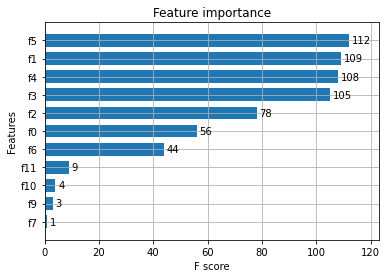

In [72]:
xgb.plot_importance(model, max_num_features=28, height=0.7)

#### TensorFlow

In [176]:
input_layer = Input(shape=(X.shape[1],))
dense_layer_1 = Dense(100, activation='relu')(input_layer)
dense_layer_2 = Dense(50, activation='relu')(dense_layer_1)
dense_layer_3 = Dense(25, activation='relu')(dense_layer_2)
output = Dense(1)(dense_layer_3)

model = Model(inputs=input_layer, outputs=output)
model.compile(loss="mean_squared_error" , optimizer="adam", metrics=["mean_squared_error"])

In [177]:
print(model.summary())

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 15)]              0         
_________________________________________________________________
dense_5 (Dense)              (None, 100)               1600      
_________________________________________________________________
dense_6 (Dense)              (None, 50)                5050      
_________________________________________________________________
dense_7 (Dense)              (None, 25)                1275      
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 26        
Total params: 7,951
Trainable params: 7,951
Non-trainable params: 0
_________________________________________________________________
None


In [179]:
history = model.fit(X_train, y_train, batch_size=2, epochs=5, verbose=1, validation_split=0.2)

Epoch 1/5
110525/110525 [==============================] - 166s 1ms/step - loss: 1.3237 - mean_squared_error: 1.3237 - val_loss: 1.1605 - val_mean_squared_error: 1.1605 - ETA: 15s - loss: 1.3286 - mean_sq - ETA: 
Epoch 2/5
110525/110525 [==============================] - 148s 1ms/step - loss: 1.2074 - mean_squared_error: 1.2074 - val_loss: 1.2335 - val_mean_squared_error: 1.2335
Epoch 3/5
110525/110525 [==============================] - 153s 1ms/step - loss: 1.1750 - mean_squared_error: 1.1750 - val_loss: 1.2695 - val_mean_squared_error: 1.2695
Epoch 4/5
110525/110525 [==============================] - 162s 1ms/step - loss: 1.1592 - mean_squared_error: 1.1592 - val_loss: 1.0623 - val_mean_squared_error: 1.0623
Epoch 5/5
110525/110525 [==============================] - 162s 1ms/step - loss: 1.1525 - mean_squared_error: 1.1525 - val_loss: 1.1585 - val_mean_squared_error: 1.1585


In [182]:
pred_train = model.predict(X_train)
pred = model.predict(X_test)

print(f"MSE training: {np.sqrt(mean_squared_error(y_train,pred_train))}, MSE testing: {np.sqrt(mean_squared_error(y_test,pred))}")

MSE training: 1.0784860518595667, MSE testing: 1.0823898036288786
